
<div>
<img src="attachment:creditcard.jpg" width="500" align = "left" />
</div>

In [283]:
import numpy as np
import pandas as pd
import pickle
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import warnings
%matplotlib inline
warnings.filterwarnings("ignore")

In [284]:
import pandas as pd
import matplotlib.pyplot as plt

# Show all rows and columns in DataFrame output
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

pd.set_option('display.max_colwidth', None)

pd.set_option('display.width', 0)  

In [285]:
# loading train transaction data
train_transaction = pd.read_csv('data/train_transaction.csv')
train_transaction.shape



(590540, 394)

In [286]:
# Loading train identity data
train_identity = pd.read_csv('data/train_identity.csv')
print(train_identity.shape)


(144233, 41)


In [287]:
# We merge both transaction & identity train data
train_df = pd.merge(train_transaction, train_identity, how ='left')
print(train_df.shape)

print(train_df.head(10))


del train_transaction, train_identity


(590540, 434)
   TransactionID  isFraud  TransactionDT  TransactionAmt ProductCD  card1  \
0        2987000        0          86400            68.5         W  13926   
1        2987001        0          86401            29.0         W   2755   
2        2987002        0          86469            59.0         W   4663   
3        2987003        0          86499            50.0         W  18132   
4        2987004        0          86506            50.0         H   4497   
5        2987005        0          86510            49.0         W   5937   
6        2987006        0          86522           159.0         W  12308   
7        2987007        0          86529           422.5         W  12695   
8        2987008        0          86535            15.0         H   2803   
9        2987009        0          86536           117.0         W  17399   

   card2  card3       card4  card5   card6  addr1  addr2  dist1  dist2  \
0    NaN  150.0    discover  142.0  credit  315.0   87.0   19.0 

The train dataset consists of 590540 datapoints, and the merged dataset has about 434 features. 

In [288]:

#loading test transaction data
test_transaction = pd.read_csv('data/test_transaction.csv')
print(test_transaction.shape)



(506691, 393)


In [289]:
# Loading test identity data
test_identity = pd.read_csv('data/test_identity.csv')
print(test_identity.shape)

test_identity.head(10)


(141907, 41)


,TransactionID,id-01,id-02,id-03,id-04,id-05,id-06,id-07,id-08,id-09,id-10,id-11,id-12,id-13,id-14,id-15,id-16,id-17,id-18,id-19,id-20,id-21,id-22,id-23,id-24,id-25,id-26,id-27,id-28,id-29,id-30,id-31,id-32,id-33,id-34,id-35,id-36,id-37,id-38,DeviceType,DeviceInfo
0,3663586,-45.0,280290.0,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,100.0,NotFound,27.0,NaN,New,NotFound,225.0,15.0,427.0,563.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New,NotFound,NaN,chrome 67.0 for android,NaN,NaN,NaN,F,F,T,F,mobile,MYA-L13 Build/HUAWEIMYA-L13
1,3663588,0.0,3579.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,100.0,Found,NaN,-300.0,Found,Found,166.0,NaN,542.0,368.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Found,Found,Android 6.0.1,chrome 67.0 for android,24.0,1280x720,match_status:2,T,F,T,T,mobile,LGLS676 Build/MXB48T
2,3663597,-5.0,185210.0,NaN,NaN,1.0,0.0,NaN,NaN,NaN,NaN,100.0,NotFound,52.0,-360.0,New,NotFound,225.0,NaN,271.0,507.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New,NotFound,NaN,ie 11.0 for tablet,NaN,NaN,NaN,F,T,T,F,desktop,Trident/7.0
3,3663601,-45.0,252944.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,100.0,NotFound,27.0,NaN,Found,Found,225.0,15.0,427.0,563.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Found,Found,NaN,chrome 67.0 for android,NaN,NaN,NaN,F,F,T,F,mobile,MYA-L13 Build/HUAWEIMYA-L13
4,3663602,-95.0,328680.0,NaN,NaN,7.0,-33.0,NaN,NaN,NaN,NaN,100.0,NotFound,27.0,NaN,New,NotFound,225.0,15.0,567.0,507.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New,NotFound,NaN,chrome 67.0 for android,NaN,NaN,NaN,F,F,T,F,mobile,SM-G9650 Build/R16NW
5,3663622,-5.0,36786.0,NaN,NaN,4.0,-2.0,NaN,NaN,NaN,NaN,100.0,NotFound,27.0,-480.0,New,NotFound,166.0,15.0,352.0,177.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New,NotFound,iOS 11.4.0,mobile safari 11.0,32.0,2208x1242,match_status:2,T,F,F,T,mobile,iOS Device
6,3663624,-5.0,12577.0,0.0,0.0,2.0,-2.0,NaN,NaN,0.0,0.0,100.0,Found,27.0,-480.0,Found,Found,166.0,15.0,352.0,177.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Found,Found,iOS 11.4.0,mobile safari 11.0,32.0,2208x1242,match_status:2,T,F,F,T,mobile,iOS Device
7,3663626,-5.0,44726.0,0.0,0.0,0.0,-2.0,NaN,NaN,0.0,0.0,100.0,Found,27.0,-480.0,Found,Found,166.0,15.0,352.0,177.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Found,Found,iOS 11.4.0,mobile safari 11.0,32.0,2208x1242,match_status:2,T,F,F,T,mobile,iOS Device
8,3663629,-5.0,125997.0,0.0,0.0,2.0,-2.0,NaN,NaN,0.0,0.0,100.0,Found,27.0,-480.0,Found,Found,166.0,15.0,352.0,177.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Found,Found,iOS 11.4.0,mobile safari 11.0,32.0,2208x1242,match_status:2,T,F,F,T,mobile,iOS Device
9,3663658,-5.0,98741.0,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,100.0,Found,27.0,-360.0,New,NotFound,166.0,NaN,529.0,214.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,New,NotFound,iOS 11.4.0,mobile safari 11.0,32.0,2048x1536,match_status:2,T,F,F,F,mobile,iOS Device


In [290]:
#merging test transaction and identity table
test_df = pd.merge(test_transaction, test_identity, how='left')

del test_transaction, test_identity
test_df.head(10)


,TransactionID,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id-01,id-02,id-03,id-04,id-05,id-06,id-07,id-08,id-09,id-10,id-11,id-12,id-13,id-14,id-15,id-16,id-17,id-18,id-19,id-20,id-21,id-22,id-23,id-24,id-25,id-26,id-27,id-28,id-29,id-30,id-31,id-32,id-33,id-34,id-35,id-36,id-37,id-38,DeviceType,DeviceInfo
0,3663549,18403224,31.95,W,10409,111.0,150.0,visa,226.0,debit,170.0,87.0,1.0,NaN,gmail.com,NaN,6.0,6.0,0.0,0.0,3.0,4.0,0.0,0.0,6.0,0.0,5.0,1.0,115.0,6.0,419.0,419.0,27.0,398.0,27.0,NaN,NaN,NaN,NaN,418.0,203.0,NaN,NaN,NaN,409.0,T,T,F,NaN,NaN,F,T,T,T,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,47.950001,0.000000,0.000000,47.950001,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,47.950001,0.000000,0.000000,47.950001,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3663550,18403263,49.00,W,4272,111.0,150.0,vis

In [291]:

# Display basic info of the test and train data
print("="*40 + " TRAIN DATA INFO " + "="*40)
train_df.info()
print("\n" + "="*40 + " TEST DATA INFO " + "="*40)
test_df.info()

# Number of rows and columns
print("\nTrain shape:", train_df.shape)
print("Test shape:", test_df.shape)

# Data types summary
print("\nTrain data types:")
print(train_df.dtypes.value_counts())
print("\nTest data types:")
print(test_df.dtypes.value_counts())

# Display basic statistics (numerical columns only)
print("\nTrain Describe:\n", train_df.describe().T)
print("\nTest Describe:\n", test_df.describe().T)



======================================== TRAIN DATA INFO ========================================
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 590540 entries, 0 to 590539
Columns: 434 entries, TransactionID to DeviceInfo
dtypes: float64(399), int64(4), object(31)
memory usage: 1.9+ GB

======================================== TEST DATA INFO ========================================
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 506691 entries, 0 to 506690
Columns: 433 entries, TransactionID to DeviceInfo
dtypes: float64(399), int64(3), object(31)
memory usage: 1.6+ GB

Train shape: (590540, 434)
Test shape: (506691, 433)

Train data types:
float64    399
object      31
int64        4
Name: count, dtype: int64

Test data types:
float64    399
object      31
int64        3
Name: count, dtype: int64

Train Describe:
                    count          mean           std          min  \
TransactionID   590540.0  3.282270e+06  1.704744e+05  2987000.000   
isFraud         590540.0  3.4

In [292]:
#Train data column count and their values
print("Total number of columns are:",train_df.shape[1])

print("The train features are:" , train_df.columns.tolist())

Total number of columns are: 434
The train features are: ['TransactionID', 'isFraud', 'TransactionDT', 'TransactionAmt', 'ProductCD', 'card1', 'card2', 'card3', 'card4', 'card5', 'card6', 'addr1', 'addr2', 'dist1', 'dist2', 'P_emaildomain', 'R_emaildomain', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'D1', 'D2', 'D3', 'D4', 'D5', 'D6', 'D7', 'D8', 'D9', 'D10', 'D11', 'D12', 'D13', 'D14', 'D15', 'M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31', 'V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'V38', 'V39', 'V40', 'V41', 'V42', 'V43', 'V44', 'V45', 'V46', 'V47', 'V48', 'V49', 'V50', 'V51', 'V52', 'V53', 'V54', 'V55', 'V56', 'V57', 'V58', 'V59', 'V60', 'V61', 'V62', 'V63', 'V64', 'V65', 'V66', 'V67', 'V68', 'V69', 'V70', 'V71', 'V72', 'V73', '

In [293]:
#Test data column count and their values
print("Total number of columns are:",test_df.shape[1])

print("The test features are:" , test_df.columns.tolist())

Total number of columns are: 433
The test features are: ['TransactionID', 'TransactionDT', 'TransactionAmt', 'ProductCD', 'card1', 'card2', 'card3', 'card4', 'card5', 'card6', 'addr1', 'addr2', 'dist1', 'dist2', 'P_emaildomain', 'R_emaildomain', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'D1', 'D2', 'D3', 'D4', 'D5', 'D6', 'D7', 'D8', 'D9', 'D10', 'D11', 'D12', 'D13', 'D14', 'D15', 'M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31', 'V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'V38', 'V39', 'V40', 'V41', 'V42', 'V43', 'V44', 'V45', 'V46', 'V47', 'V48', 'V49', 'V50', 'V51', 'V52', 'V53', 'V54', 'V55', 'V56', 'V57', 'V58', 'V59', 'V60', 'V61', 'V62', 'V63', 'V64', 'V65', 'V66', 'V67', 'V68', 'V69', 'V70', 'V71', 'V72', 'V73', 'V74', 'V75',

In [294]:
test_df.columns = test_df.columns.str.replace('^id-', 'id_', regex=True)

print(test_df.columns.tolist())

['TransactionID', 'TransactionDT', 'TransactionAmt', 'ProductCD', 'card1', 'card2', 'card3', 'card4', 'card5', 'card6', 'addr1', 'addr2', 'dist1', 'dist2', 'P_emaildomain', 'R_emaildomain', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'D1', 'D2', 'D3', 'D4', 'D5', 'D6', 'D7', 'D8', 'D9', 'D10', 'D11', 'D12', 'D13', 'D14', 'D15', 'M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31', 'V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'V38', 'V39', 'V40', 'V41', 'V42', 'V43', 'V44', 'V45', 'V46', 'V47', 'V48', 'V49', 'V50', 'V51', 'V52', 'V53', 'V54', 'V55', 'V56', 'V57', 'V58', 'V59', 'V60', 'V61', 'V62', 'V63', 'V64', 'V65', 'V66', 'V67', 'V68', 'V69', 'V70', 'V71', 'V72', 'V73', 'V74', 'V75', 'V76', 'V77', 'V78', 'V79', 'V80', 'V81', 'V82', 'V83',

In [295]:
#Features datatypes & features count based on their datatype

# Display column data types
print("="*40 + " COLUMN DATA TYPES " + "="*40)
print(train_df.dtypes.sort_values())
print()

# Summary of data type counts
print("="*40 + " DATA TYPE COUNTS " + "="*40)
dtype_counts = train_df.dtypes.value_counts()
for dtype, count in dtype_counts.items():
    print(f"{str(dtype):<15} : {count} columns")



======================================== COLUMN DATA TYPES ========================================
TransactionID       int64
isFraud             int64
TransactionDT       int64
card1               int64
V232              float64
V231              float64
V230              float64
V229              float64
V228              float64
V227              float64
V226              float64
V225              float64
V224              float64
V223              float64
V222              float64
V220              float64
V233              float64
V219              float64
V218              float64
V217              float64
V216              float64
V215              float64
V214              float64
V213              float64
V212              float64
V211              float64
V221              float64
V234              float64
V236              float64
V210              float64
V258              float64
V257              float64
V256              float64
V255              float64
V254            

In [296]:
# Check unique values pattern for all features
for col in train_df.columns:
    values = train_df[col]
    num_uniques = values.nunique()
    uniques = values.unique()
    
    print(f"{col:<25} | Unique Values: {num_uniques}")
    
    # Show values depending on how many there are
    if num_uniques <= 30:
        print("Values:", uniques)
    else:
        print("Values (first 30):", uniques[:30])
    
    print("-" * 60)


TransactionID             | Unique Values: 590540
Values (first 30): [2987000 2987001 2987002 2987003 2987004 2987005 2987006 2987007 2987008
 2987009 2987010 2987011 2987012 2987013 2987014 2987015 2987016 2987017
 2987018 2987019 2987020 2987021 2987022 2987023 2987024 2987025 2987026
 2987027 2987028 2987029]
------------------------------------------------------------
isFraud                   | Unique Values: 2
Values: [0 1]
------------------------------------------------------------
TransactionDT             | Unique Values: 573349
Values (first 30): [86400 86401 86469 86499 86506 86510 86522 86529 86535 86536 86549 86555
 86564 86585 86596 86618 86620 86668 86725 86730 86761 86769 86786 86808
 86821 86944 86945 86972 86973 86979]
------------------------------------------------------------
TransactionAmt            | Unique Values: 20902
Values (first 30): [ 68.5    29.     59.     50.     49.    159.    422.5    15.    117.
  75.887  16.495  40.     10.5    57.95   30.    100.

In [297]:
# Percentage of missing data in train and test datasets
def missing_percentage(df, name="DataFrame"):
    total_cells = df.shape[0] * df.shape[1]
    total_missing = df.isnull().sum().sum()
    missing_pct = (total_missing / total_cells) * 100
    print(f"Missing data in {name}: {missing_pct:.3f}%")

missing_percentage(train_df, "Train")
missing_percentage(test_df, "Test")



Missing data in Train: 45.074%
Missing data in Test: 41.107%


In [298]:
import pandas as pd
import numpy as np

def get_missing_info(df, sort=True, ascending=False):
   
    total_rows = df.shape[0]
    
    missing_data = [
        (col, df[col].isna().sum(), round(df[col].isna().mean() * 100, 3))
        for col in df.columns
        if df[col].isna().sum() > 0
    ]
    
    missing_df = pd.DataFrame(missing_data, columns=["Feature", "Missing_input", "Percentage of missing input"])
    
    if sort:
        missing_df = missing_df.sort_values(by="Percentage of missing input", ascending=ascending).reset_index(drop=True)
    
    return missing_df

# Get missing info for train and test datasets
missing_train = get_missing_info(train_df)
missing_test = get_missing_info(test_df)

# Display results
print("Missing in Train:\n", missing_train)
#print("\nMissing in Test:\n", missing_test.head())



Missing in Train:
            Feature  Missing_input  Percentage of missing input
0            id_24         585793                       99.196
1            id_25         585408                       99.131
2            id_07         585385                       99.127
3            id_08         585385                       99.127
4            id_26         585377                       99.126
5            id_21         585381                       99.126
6            id_27         585371                       99.125
7            id_23         585371                       99.125
8            id_22         585371                       99.125
9            dist2         552913                       93.628
10              D7         551623                       93.410
11           id_18         545427                       92.361
12             D13         528588                       89.509
13             D14         528353                       89.469
14             D12         525823   

# Analyzing the features in the dataset

## is_fraud
0 = legit transaction <br>
1 = fraud transaction.

In [299]:

print(train_df['isFraud'].value_counts())



isFraud
0    569877
1     20663
Name: count, dtype: int64


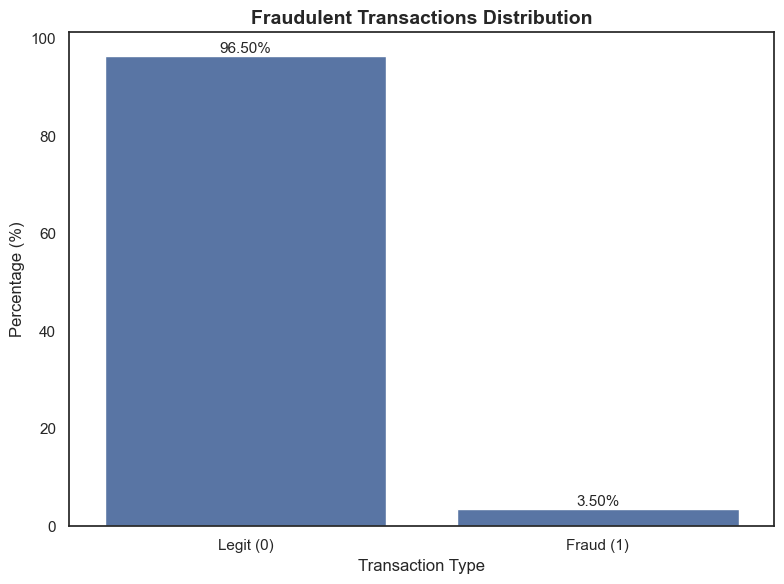

In [300]:
# Disable grid lines
sns.set_theme(style="white")

# Data
fraud_counts = train_df['isFraud'].value_counts(normalize=True) * 100
labels = fraud_counts.index.map({0: 'Legit (0)', 1: 'Fraud (1)'})

# Plot
plt.figure(figsize=(8, 6))
ax = sns.barplot(x=labels, y=fraud_counts.values)

# Annotate bars
for p in ax.patches:
    height = p.get_height()
    ax.annotate(f'{height:.2f}%', 
                (p.get_x() + p.get_width() / 2., height),
                ha='center', va='bottom', fontsize=11)

# Titles and labels
plt.title("Fraudulent Transactions Distribution", fontsize=14, fontweight='bold')
plt.xlabel("Transaction Type", fontsize=12)
plt.ylabel("Percentage (%)", fontsize=12)

plt.tight_layout()
plt.show()



# TransactionDT 

Timedelta



In [301]:
#TransactionDT feature description

train_df[['TransactionDT']].describe().astype(int)
print( train_df[['TransactionDT']]  )

        TransactionDT
0               86400
1               86401
2               86469
3               86499
4               86506
5               86510
6               86522
7               86529
8               86535
9               86536
10              86549
11              86555
12              86564
13              86585
14              86596
15              86618
16              86620
17              86668
18              86725
19              86730
20              86761
21              86769
22              86786
23              86808
24              86821
25              86944
26              86945
27              86972
28              86973
29              86979
30              86994
31              86998
32              87008
33              87078
34              87135
35              87140
36              87149
37              87161
38              87172
39              87202
40              87209
41              87220
42              87233
43              87248
44        

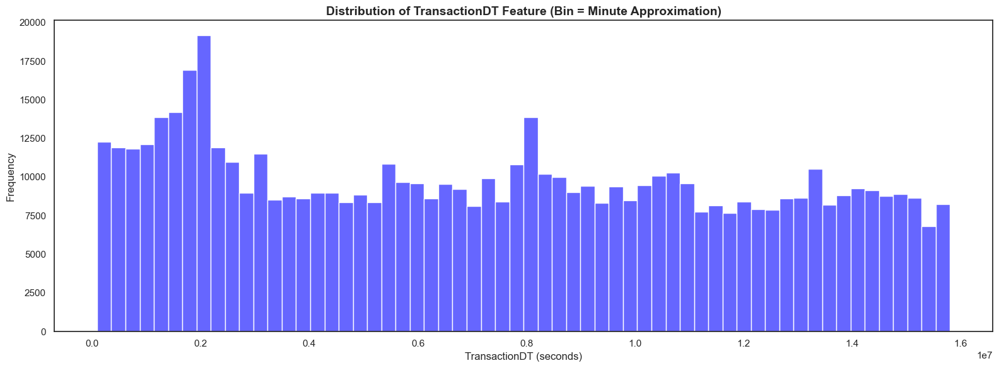

In [302]:
plt.figure(figsize=(16, 6))

# Plot train
sns.histplot(train_df['TransactionDT'], bins=60, color='blue', alpha=0.6)


# Labels and title
plt.xlabel('TransactionDT (seconds)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.title('Distribution of TransactionDT Feature (Bin = Minute Approximation)', fontsize=14, fontweight='bold')

# Legend
plt.tight_layout()
plt.show()




# Transaction Amt


In [303]:
train_df["TransactionAmt"].nunique()

20902

In [304]:
print("Transaction Amount Statistics (Train Set)")
print(train_df['TransactionAmt'].describe().apply(lambda x: format(x, '.2f')))
print("\n" + "*" * 40 + "\n")

print("Transaction Amount Statistics (Test Set)")
print(test_df['TransactionAmt'].describe().apply(lambda x: format(x, '.2f')))



Transaction Amount Statistics (Train Set)
count    590540.00
mean        135.03
std         239.16
min           0.25
25%          43.32
50%          68.77
75%         125.00
max       31937.39
Name: TransactionAmt, dtype: object

****************************************

Transaction Amount Statistics (Test Set)
count    506691.00
mean        134.73
std         245.78
min           0.02
25%          40.00
50%          67.95
75%         125.00
max       10270.00
Name: TransactionAmt, dtype: object


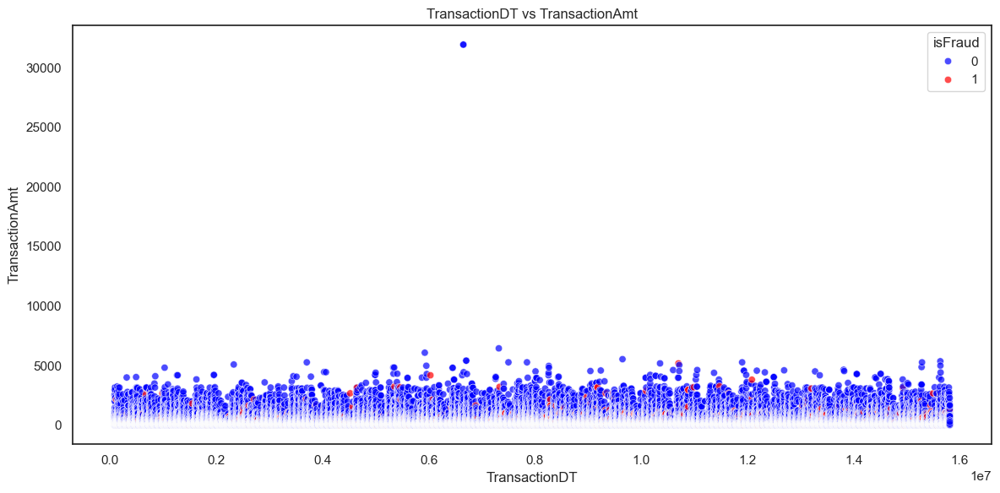

In [305]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(12, 6))

sns.scatterplot(
    x="TransactionDT",
    y="TransactionAmt",
    hue="isFraud",
    data=train_df,
    alpha=0.7,
    palette={0: "blue", 1: "red"},
    hue_order=[0, 1]
)

plt.title("TransactionDT vs TransactionAmt")
plt.xlabel("TransactionDT")
plt.ylabel("TransactionAmt")
plt.legend(title="isFraud")

plt.tight_layout()
plt.show()



In [306]:
#checking outliers datapoints
train_df[train_df.TransactionAmt > 30000]


,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_03,id_04,id_05,id_06,id_07,id_08,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_18,id_19,id_20,id_21,id_22,id_23,id_24,id_25,id_26,id_27,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
274336,3261336,0,6652360,31937.391,W,16075,514.0,150.0,mastercard,102.0,credit,205.0,87.0,27.0,NaN,yahoo.com,NaN,1.0,2.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,0.0,T,T,T,NaN,NaN,NaN,F,F,T,1.0,3.0,3.0,2.0,2.0,2.0,2.0,2.0,2.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,2.0,2.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,2.0,2.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,2.0,2.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,0.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,2.0,2.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1422.390015,1422.390015,1422.390015,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,1422.390015,1422.390015,1422.390015,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
274339,3261339,0,6652391,3

In [307]:
#removing outliers from train data
train_df = train_df[train_df['TransactionAmt'] < 30000]


# Product CD


In [308]:
train_df["ProductCD"].dtype

dtype('O')

In [309]:
train_df["ProductCD"].nunique()

5

In [310]:
train_df["ProductCD"].value_counts()

ProductCD
W    439668
C     68519
R     37699
H     33024
S     11628
Name: count, dtype: int64

## Card1 - Card6



In [311]:
card_features = ['card1', 'card2', 'card3', 'card4', 'card5', 'card6']

print("Card Feature Data Types:\n" + "-"*30)
for feature in card_features:
    dtype = train_df[feature].dtype
    print(f"{feature:<6}: {dtype}")


Card Feature Data Types:
------------------------------
card1 : int64
card2 : float64
card3 : float64
card4 : object
card5 : float64
card6 : object


In [312]:
#null values check
train_df[["card1","card2","card3","card4","card5","card6"]].isnull().sum()

card1       0
card2    8933
card3    1565
card4    1577
card5    4259
card6    1571
dtype: int64

As we can see the count of null values in card feature is 0 only for card 1 feature.

In [313]:
# Identify all card-related columns
cards = [col for col in train_df.columns if col.startswith('card')]

# Display a summary
print(f"Total card features found: {len(cards)}")
print("Card feature names:", cards)

# Show the first few rows of card features
print("\nSample values (first 20 rows):")
display(train_df[cards].head(20))


Total card features found: 6
Card feature names: ['card1', 'card2', 'card3', 'card4', 'card5', 'card6']

Sample values (first 20 rows):


,card1,card2,card3,card4,card5,card6
0,13926,NaN,150.0,discover,142.0,credit
1,2755,404.0,150.0,mastercard,102.0,credit
2,4663,490.0,150.0,visa,166.0,debit
3,18132,567.0,150.0,mastercard,117.0,debit
4,4497,514.0,150.0,mastercard,102.0,credit
5,5937,555.0,150.0,visa,226.0,debit
6,12308,360.0,150.0,visa,166.0,debit
7,12695,490.0,150.0,visa,226.0,debit
8,2803,100.0,150.0,visa,226.0,debit
9,17399,111.0,150.0,mastercard,224.0,debit


In [314]:
# Unique value counts for card features
print("Unique Value Counts for Card Features:\n" + "-" * 40)

for col in cards:
    count = train_df[col].nunique()
    print(f"{col:<6} : {count:,}")


Unique Value Counts for Card Features:
----------------------------------------
card1  : 13,553
card2  : 500
card3  : 114
card4  : 4
card5  : 119
card6  : 4


In [315]:
# Descriptive statistics for 'card1' in train and test sets
print("Descriptive Statistics for 'card1' (Train Set)")
print(train_df["card1"].describe().apply(lambda x: f"{x:,.0f}"))

print("\n" + "*" * 40 + "\n")


Descriptive Statistics for 'card1' (Train Set)
count    590,538
mean       9,899
std        4,901
min        1,000
25%        6,019
50%        9,678
75%       14,183
max       18,396
Name: card1, dtype: object

****************************************



In [316]:
# Descriptive statistics for 'card2' in train and test sets
print("Descriptive Statistics for 'card2' (Train Set)")
print(train_df["card2"].describe().apply(lambda x: f"{x:,.0f}"))

print("\n" + "*" * 40 + "\n")



Descriptive Statistics for 'card2' (Train Set)
count    581,605
mean         363
std          158
min          100
25%          214
50%          361
75%          512
max          600
Name: card2, dtype: object

****************************************



In [317]:
# Descriptive statistics for 'card3' in train and test sets
print("Descriptive Statistics for 'card3' (Train Set)")
print(train_df["card3"].describe().apply(lambda x: f"{x:,.0f}"))

print("\n" + "*" * 40 + "\n")

Descriptive Statistics for 'card3' (Train Set)
count    588,973
mean         153
std           11
min          100
25%          150
50%          150
75%          150
max          231
Name: card3, dtype: object

****************************************



In [318]:
train_df['card4'].value_counts()

card4
visa                384767
mastercard          189215
american express      8328
discover              6651
Name: count, dtype: int64

In [319]:
train_df['card4'].unique()

array(['discover', 'mastercard', 'visa', 'american express', nan],
      dtype=object)

In [320]:
# Descriptive statistics for 'card5' in train and test sets
print("Descriptive Statistics for 'card5' (Train Set)")
print(train_df["card5"].describe().apply(lambda x: f"{x:,.0f}"))

print("\n" + "*" * 40 + "\n")

Descriptive Statistics for 'card5' (Train Set)
count    586,279
mean         199
std           41
min          100
25%          166
50%          226
75%          226
max          237
Name: card5, dtype: object

****************************************



In [321]:
#card6

train_df["card6"].value_counts()


card6
debit              439938
credit             148984
debit or credit        30
charge card            15
Name: count, dtype: int64

## addr1,addr2 





In [322]:
address = ['addr1','addr2']

In [323]:
for i in address:
    print(train_df[i].dtype)


float64
float64


In [324]:
# Checking for null values in address fields
address_cols = ['addr1', 'addr2']

print("Null Value Summary for Address Columns:\n" + "-"*45)

for col in address_cols:
    null_count = train_df[col].isnull().sum()
    null_pct = train_df[col].isnull().mean() * 100
    print(f"{col:<6} → Nulls: {null_count:<6,} ({null_pct:.2f}%)")


Null Value Summary for Address Columns:
---------------------------------------------
addr1  → Nulls: 65,706 (11.13%)
addr2  → Nulls: 65,706 (11.13%)


In [325]:
# Analyzing 'addr1' and "addr2" region counts in Train datasets
print("Train Set — 'addr1' Region Summary")
print(f"Total unique regions: {train_df['addr1'].nunique():,}")
print("Top 10 most frequent regions:")
print(train_df['addr1'].value_counts().head(10), end="\n\n")

print("\n" + "*" * 40 + "\n")

print("Train Set — 'addr1' Region Summary")
print(f"Total unique regions: {train_df['addr1'].nunique():,}")
print("Top 10 most frequent regions:")
print(train_df['addr2'].value_counts().head(10), end="\n\n")


Train Set — 'addr1' Region Summary
Total unique regions: 332
Top 10 most frequent regions:
addr1
299.0    46335
325.0    42751
204.0    42020
264.0    39870
330.0    26287
315.0    23078
441.0    20827
272.0    20141
123.0    16105
126.0    15243
Name: count, dtype: int64


****************************************

Train Set — 'addr1' Region Summary
Total unique regions: 332
Top 10 most frequent regions:
addr2
87.0    520479
60.0      3084
96.0       638
32.0        91
65.0        82
16.0        55
31.0        47
19.0        33
26.0        25
27.0        20
Name: count, dtype: int64



In [326]:
print("Train description\n", train_df['addr1'].describe())


Train description
 count    524832.000000
mean        290.734121
std         101.741128
min         100.000000
25%         204.000000
50%         299.000000
75%         330.000000
max         540.000000
Name: addr1, dtype: float64


In [327]:
print("Train description\n", train_df['addr2'].describe())


Train description
 count    524832.000000
mean         86.800630
std           2.690629
min          10.000000
25%          87.000000
50%          87.000000
75%          87.000000
max         102.000000
Name: addr2, dtype: float64


## dist1,dist2 

In [328]:
# Define distance-related features
distance_features = ['dist1', 'dist2']


In [329]:
for i in distance_features:
    print(train_df[i].dtype)

float64
float64


In [330]:
# Descriptive statistics for distance-related features
distance_features = ['dist1', 'dist2']

for col in distance_features:
    print(f"Descriptive Statistics for '{col}' (Train Set)")
    print(train_df[col].describe().apply(lambda x: f"{x:,.2f}"))
    print("-" * 50)


Descriptive Statistics for 'dist1' (Train Set)
count    238,267.00
mean         118.50
std          371.87
min            0.00
25%            3.00
50%            8.00
75%           24.00
max       10,286.00
Name: dist1, dtype: object
--------------------------------------------------
Descriptive Statistics for 'dist2' (Train Set)
count    37,627.00
mean        231.86
std         529.05
min           0.00
25%           7.00
50%          37.00
75%         206.00
max      11,623.00
Name: dist2, dtype: object
--------------------------------------------------


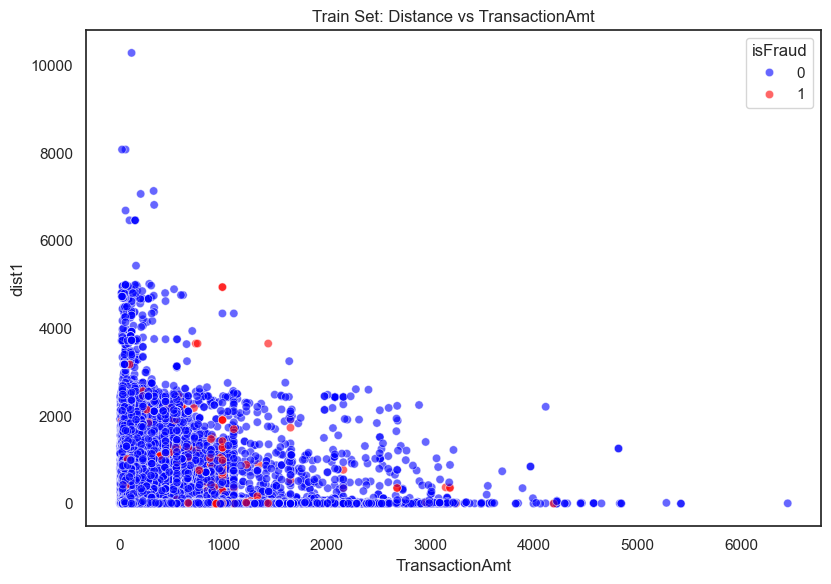

In [331]:

train_dist1 = train_df[train_df['dist1'].notnull()]


plt.figure(figsize=(16, 6))

plt.subplot(1, 2, 1)
sns.scatterplot(
    x="TransactionAmt", 
    y="dist1", 
    hue="isFraud", 
    data=train_dist1, 
    alpha=0.6, 
    palette={0: "blue", 1: "red"},
    hue_order=[0, 1]
)
plt.title("Train Set: Distance vs TransactionAmt")
plt.xlabel("TransactionAmt")
plt.ylabel("dist1")
plt.legend(title="isFraud")

plt.tight_layout()
plt.show()



dist1 > 6000 are outliers 

In [332]:
train_df.drop(train_df[train_df['dist1'] > 6000].index, axis=0, inplace = True)

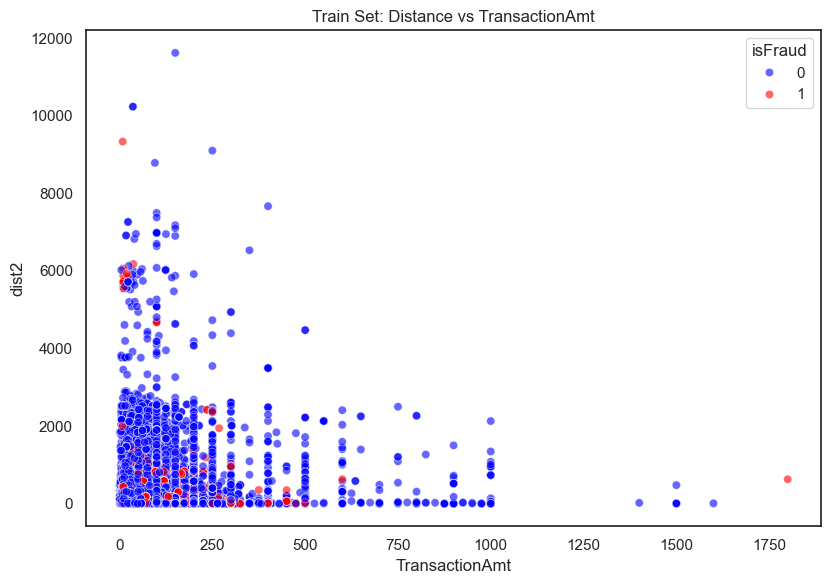

In [333]:
train_dist2 = train_df[train_df['dist2'].notnull()]

plt.figure(figsize=(16, 6))

plt.subplot(1, 2, 1)
sns.scatterplot(
    x="TransactionAmt", 
    y="dist2", 
    hue="isFraud", 
    data=train_dist2, 
    alpha=0.6, 
    palette={0: "blue", 1: "red"},
    hue_order=[0, 1]
)
plt.title("Train Set: Distance vs TransactionAmt")
plt.xlabel("TransactionAmt")
plt.ylabel("dist2")
plt.legend(title="isFraud")

plt.tight_layout()
plt.show()


dist2 > 8000 are outliers in Train so let's remove them

In [334]:
train_df.drop(train_df[train_df['dist2'] > 8000].index, axis=0, inplace=True)

## Emails: P_email domain and R_email domain 

In [335]:
email = ['P_emaildomain','R_emaildomain']

In [336]:
#email 
print(train_df['R_emaildomain'].value_counts().head(10))
print("================================================")
print(train_df['P_emaildomain'].value_counts().head(10))



R_emaildomain
gmail.com        57144
hotmail.com      27509
anonymous.com    20527
yahoo.com        11841
aol.com           3701
outlook.com       2507
comcast.net       1812
yahoo.com.mx      1508
icloud.com        1398
msn.com            852
Name: count, dtype: int64
P_emaildomain
gmail.com        228341
yahoo.com        100932
hotmail.com       45250
anonymous.com     36996
aol.com           28288
comcast.net        7888
icloud.com         6267
outlook.com        5096
msn.com            4092
att.net            4033
Name: count, dtype: int64


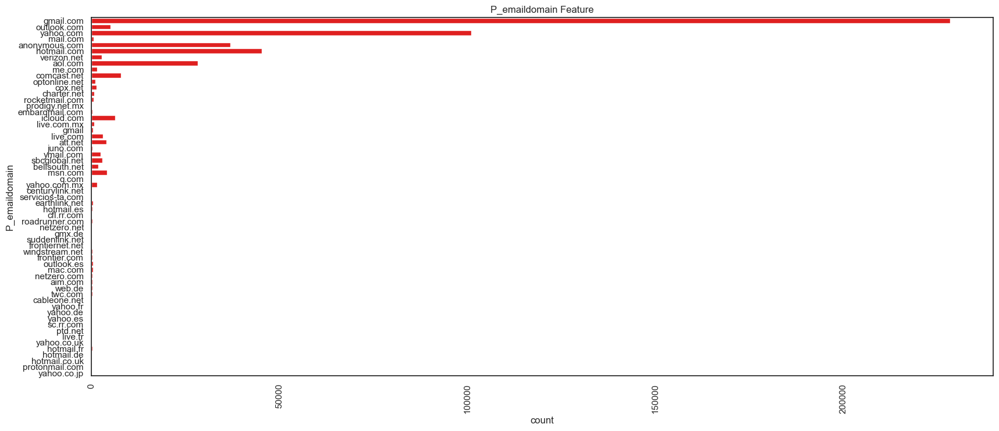

In [337]:
fig, axes = plt.subplots(nrows = 1, ncols = 1,figsize = (20,8))

#palette = sns.color_palette("Set2")  # or try 'husl', 'pastel', 'dark', etc.
#sns.countplot(x='P_emaildomain', data=train_df, ax=axes, palette=palette)

sns.countplot(train_df['P_emaildomain'], color='red')
axes.title.set_text('P_emaildomain Feature')
axes.set_xticklabels(axes.get_xticklabels(), rotation = 90)

plt.show();

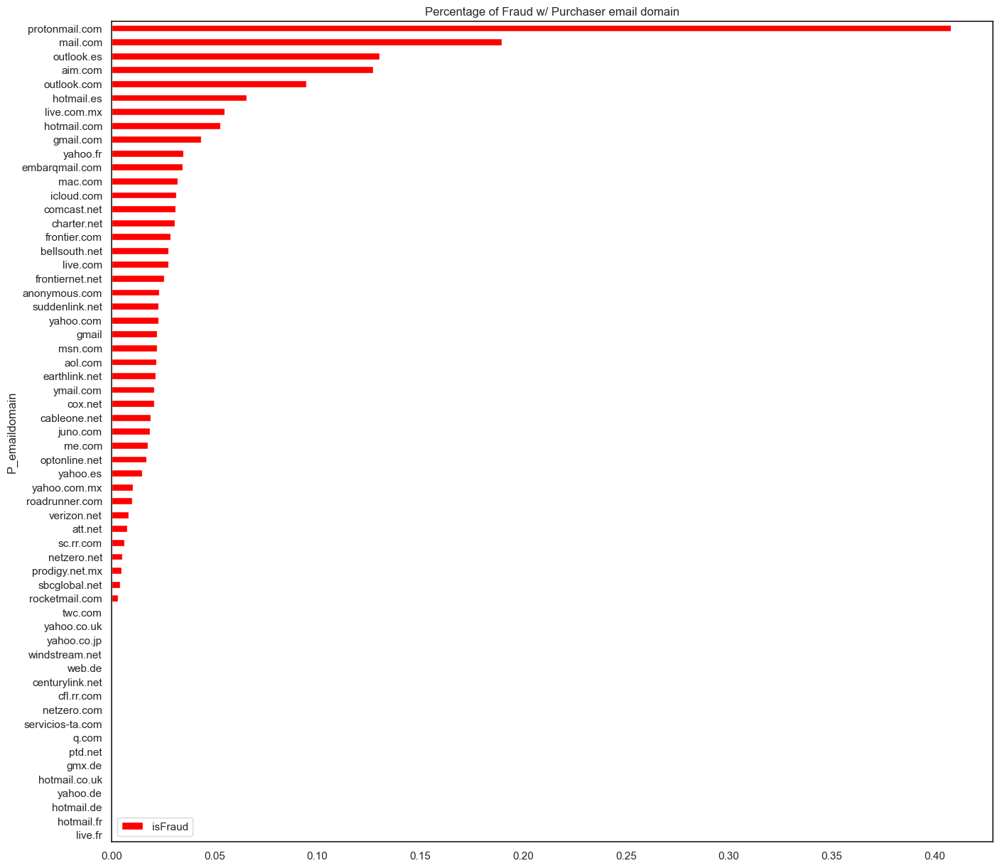

In [338]:
train_df[['P_emaildomain','isFraud']].groupby(by = ['P_emaildomain']).mean() \
        .sort_values(by = ['isFraud']).plot(kind = 'barh',
        figsize = (16, 15), color='red',
         title = 'Percentage of Fraud w/ Purchaser email domain')
plt.show()


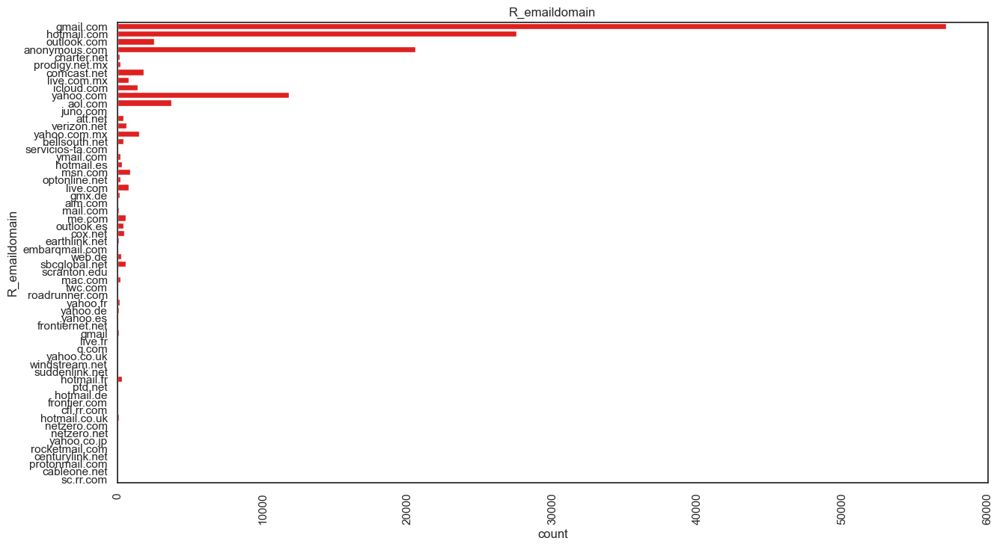

In [339]:
fig , axes = plt.subplots(nrows = 1, ncols = 1,figsize = (15, 8))

sns.countplot(train_df['R_emaildomain'], color='red')
axes.title.set_text('R_emaildomain')

axes.set_xticklabels(axes.get_xticklabels(), rotation = 90)
plt.show()

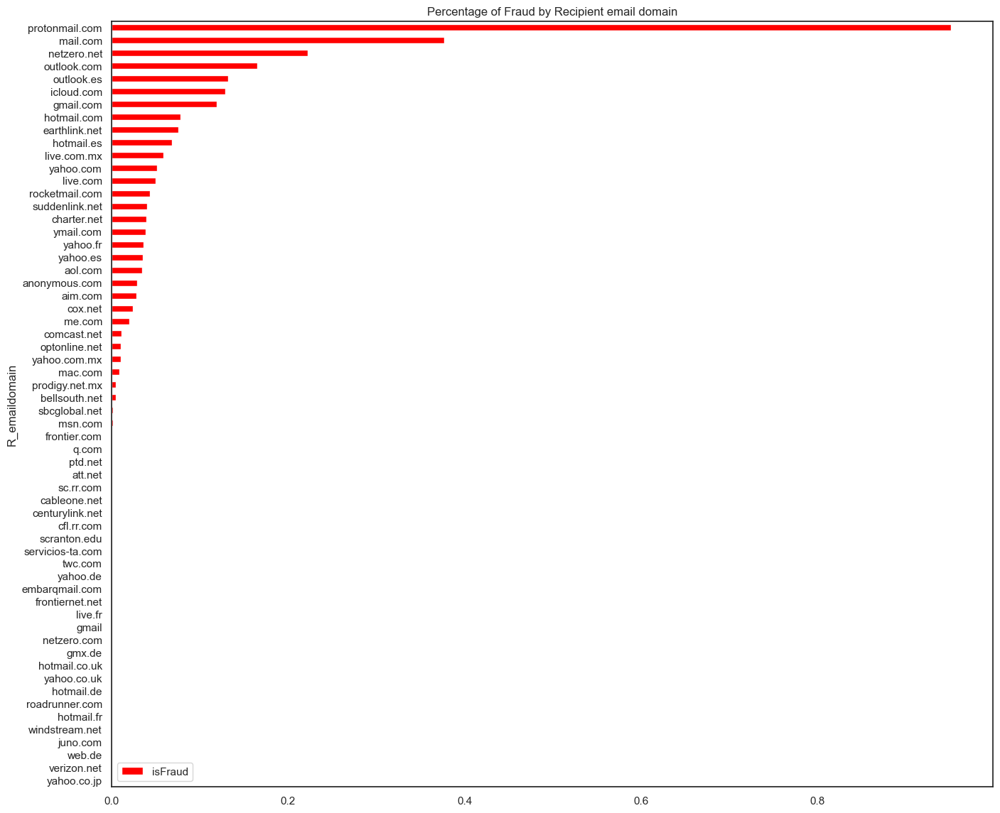

In [340]:
train_df[['R_emaildomain','isFraud']].groupby(by = ['R_emaildomain']).mean() \
        .sort_values(by = ['isFraud']).plot(kind = 'barh',
        figsize = (16, 14), color='red',
         title = 'Percentage of Fraud by Recipient email domain')
plt.show()

Observation:

1) In purchaser email domains most mails are from gmail.com.

2) Among those More fraud transaction comes from domain protonmail.com which is more than 90% which is a serious issue.

We will group all the similar e-mail domains by the respective enterprises.

Set all values with less than 500 entries as "Others" for P_emaildomain and less than 300 as others for R_emaildomain.

Also fill NaN by 'NoInfo'.

In [341]:
# Reference: https://www.kaggle.com/kabure/extensive-eda-and-modeling-xgb-hyperopt/notebook#Ploting-Transaction-Amount-Values-Distribution
train_df.loc[train_df['P_emaildomain'].isin(['gmail.com', 'gmail']),'P_emaildomain'] = 'Google'

train_df.loc[train_df['P_emaildomain'].isin(['yahoo.com', 'yahoo.com.mx',  'yahoo.co.uk', 'yahoo.co.jp', 'yahoo.de', 'yahoo.fr', 'yahoo.es']), 'P_emaildomain'] = 'Yahoo'

train_df.loc[train_df['P_emaildomain'].isin(['hotmail.com','outlook.com','msn.com', 'live.com.mx', 'hotmail.es','hotmail.co.uk', 'hotmail.de', 'outlook.es', 'live.com', 'live.fr',
                                         'hotmail.fr']), 'P_emaildomain'] = 'Microsoft'

train_df.loc[train_df.P_emaildomain.isin(train_df.P_emaildomain.value_counts()[train_df.P_emaildomain.value_counts() <= 700 ].index), 'P_emaildomain'] = "Others"

train_df.P_emaildomain.fillna("NoInfo", inplace=True)



train_df.loc[train_df['R_emaildomain'].isin(['gmail.com', 'gmail']),'R_emaildomain'] = 'Google'

train_df.loc[train_df['R_emaildomain'].isin(['yahoo.com', 'yahoo.com.mx',  'yahoo.co.uk', 'yahoo.co.jp', 'yahoo.de', 'yahoo.fr', 'yahoo.es']), 'R_emaildomain'] = 'Yahoo'

train_df.loc[train_df['R_emaildomain'].isin(['hotmail.com','outlook.com','msn.com', 'live.com.mx', 'hotmail.es','hotmail.co.uk', 'hotmail.de', 'outlook.es', 'live.com', 'live.fr',
                                             'hotmail.fr']), 'R_emaildomain'] = 'Microsoft'

train_df.loc[train_df.R_emaildomain.isin(train_df.R_emaildomain.value_counts()[train_df.R_emaildomain.value_counts() <= 500 ].index), 'R_emaildomain'] = "Others"

train_df.R_emaildomain.fillna("NoInfo", inplace=True)

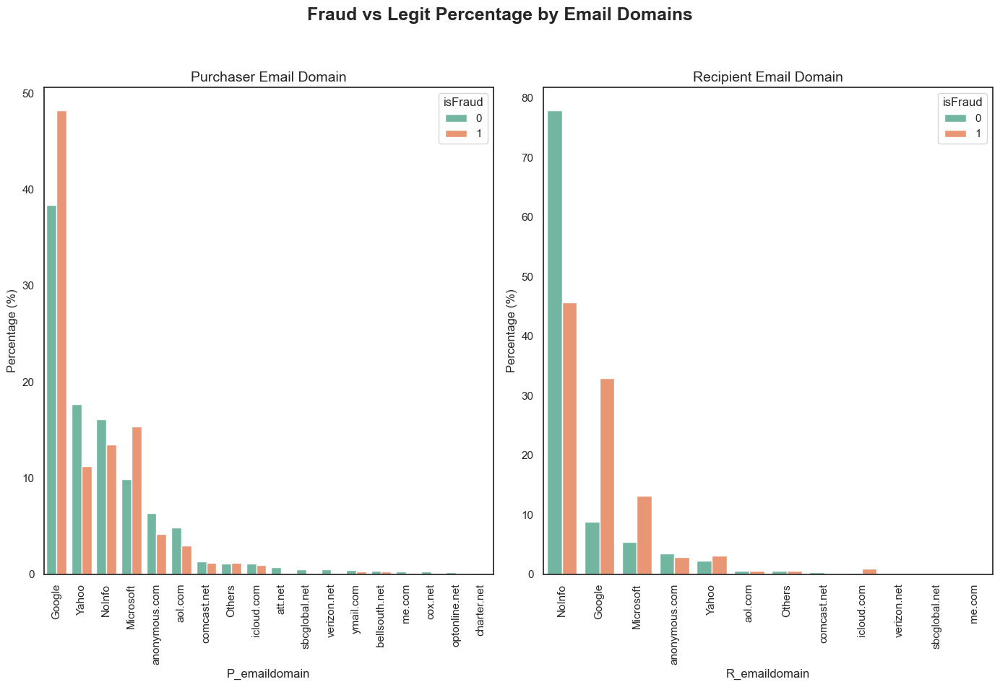

In [342]:
plt.figure(figsize=(14, 10))

# Plot for P_emaildomain
plt.subplot(1, 2, 1)
train_P_email = (
    train_df[~train_df['P_emaildomain'].isnull()]
    .groupby(['isFraud'])['P_emaildomain']
    .value_counts(normalize=True)
    .rename('percentage')
    .mul(100)
    .reset_index()
)

sns.barplot(
    x="P_emaildomain", 
    y="percentage", 
    hue="isFraud", 
    data=train_P_email, 
    palette='Set2'
)
plt.xticks(rotation=90)
plt.title("Purchaser Email Domain", fontsize=14)
plt.xlabel("P_emaildomain", fontsize=12)
plt.ylabel("Percentage (%)", fontsize=12)

# Plot for R_emaildomain
plt.subplot(1, 2, 2)
train_R_email = (
    train_df[~train_df['R_emaildomain'].isnull()]
    .groupby(['isFraud'])['R_emaildomain']
    .value_counts(normalize=True)
    .mul(100)
    .rename('percentage')
    .reset_index()
)

sns.barplot(
    x="R_emaildomain", 
    y="percentage", 
    hue="isFraud", 
    data=train_R_email, 
    palette='Set2'
)
plt.xticks(rotation=90)
plt.title("Recipient Email Domain", fontsize=14)
plt.xlabel("R_emaildomain", fontsize=12)
plt.ylabel("Percentage (%)", fontsize=12)
plt.legend(title='isFraud', loc='upper right')

# Overall title
plt.suptitle('Fraud vs Legit Percentage by Email Domains', fontsize=18, fontweight='bold')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust layout to fit suptitle

plt.show()


# 2.9 C1-C14: 

These are continous numerical features

Counts such as how many addresses are found to be associated with the payment card, etc. The actual meaning is masked.
These are like count of phone numbers, email addresses, name associated with user, device, billingaddr for both purchaser and recipient that doubles the 

C1-C14 don't have any missing value in train dataset

In [343]:
C_features = ['C1','C2','C3','C4','C5','C6','C7','C8','C9','C10','C11','C12','C13','C14']

In [344]:
c_cols = [c for c in train_df if c[0] == 'C']

train_df[c_cols].head()

,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14
0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0
1,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0
2,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0
3,2.0,5.0,0.0,0.0,0.0,4.0,0.0,0.0,1.0,0.0,1.0,0.0,25.0,1.0
4,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0


In [345]:
summary = train_df[c_cols].describe().transpose().round(2)
summary

,count,mean,std,min,25%,50%,75%,max
C1,590521.0,14.09,133.57,0.0,1.0,1.0,3.0,4685.0
C2,590521.0,15.27,154.67,0.0,1.0,1.0,3.0,5691.0
C3,590521.0,0.01,0.15,0.0,0.0,0.0,0.0,26.0
C4,590521.0,4.09,68.85,0.0,0.0,0.0,0.0,2253.0
C5,590521.0,5.57,25.79,0.0,0.0,0.0,1.0,349.0
C6,590521.0,9.07,71.51,0.0,1.0,1.0,2.0,2253.0
C7,590521.0,2.85,61.73,0.0,0.0,0.0,0.0,2255.0
C8,590521.0,5.14,95.38,0.0,0.0,0.0,0.0,3331.0
C9,590521.0,4.48,16.68,0.0,0.0,1.0,2.0,210.0
C10,590521.0,5.24,95.58,0.0,0.0,0.0,0.0,3257.0


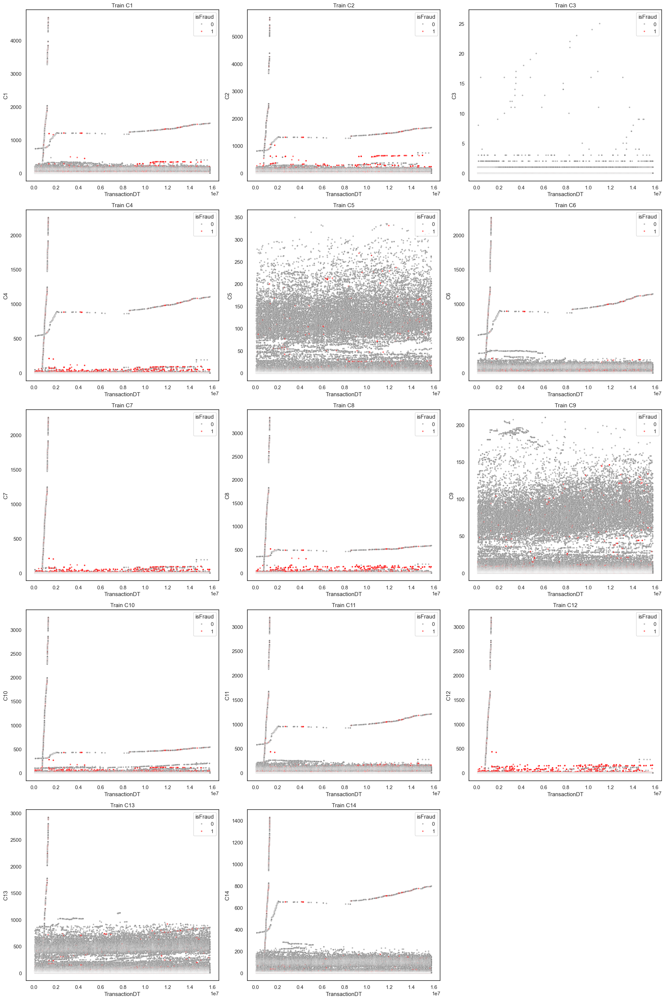

In [346]:
import math

# Define variables
var = ['C' + str(i) for i in range(1, 15)]
n_vars = len(var)
n_cols = 3
n_rows = math.ceil(n_vars / n_cols)

# Set figure size
plt.figure(figsize=(20, n_rows * 6))

# Loop through each variable and plot
for i, col in enumerate(var, 1):
    plt.subplot(n_rows, n_cols, i)
    sns.scatterplot(
        x="TransactionDT",
        y=col,
        hue="isFraud",
        data=train_df[~train_df[col].isnull()],
        palette={0: "gray", 1: "red"},
        alpha=0.6,
        s=10
    )
    plt.title(f'Train {col}', fontsize=12)
    plt.xlabel("TransactionDT")
    plt.ylabel(col)
    plt.legend(title="isFraud", loc="upper right")

# Adjust layout
plt.tight_layout()
plt.show()




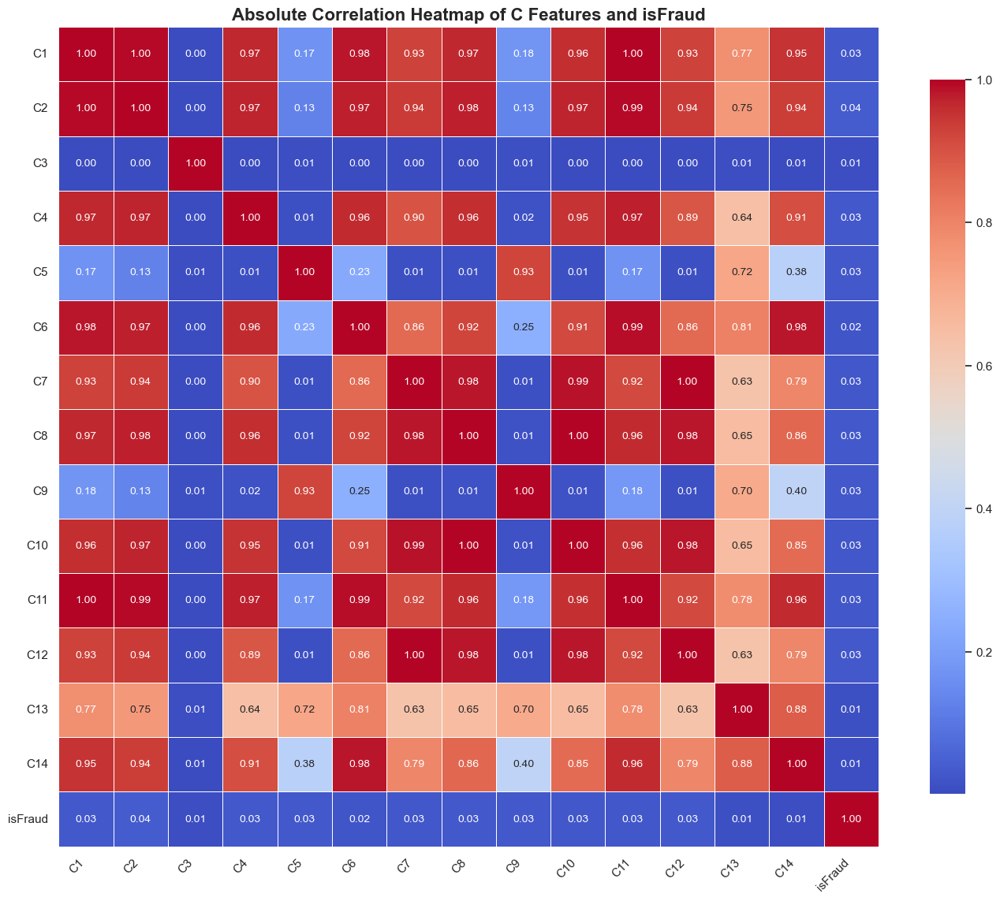

In [347]:
# Select C features + isFraud
c_cols = train_df[['C1','C2','C3','C4','C5','C6','C7','C8','C9','C10','C11','C12','C13','C14','isFraud']]

# Compute absolute correlation matrix
corr_matrix = c_cols.corr().abs()

# Plot heatmap
plt.figure(figsize=(14, 12))
sns.heatmap(
    corr_matrix, 
    annot=True, 
    fmt=".2f", 
    cmap="coolwarm", 
    square=True, 
    linewidths=0.5, 
    cbar_kws={"shrink": 0.8},
    annot_kws={"size": 10}
)
plt.title("Absolute Correlation Heatmap of C Features and isFraud", fontsize=16, fontweight='bold')
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()




Some C features are highly correlated


## D1-D15: 


In [348]:
d_cols = [f'D{i}' for i in range(1, 16)]
train_df[d_cols].head(10)


,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15
0,14.0,NaN,13.0,NaN,NaN,NaN,NaN,NaN,NaN,13.0,13.0,NaN,NaN,NaN,0.0
1,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0
2,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,315.0,NaN,NaN,NaN,315.0
3,112.0,112.0,0.0,94.0,0.0,NaN,NaN,NaN,NaN,84.0,NaN,NaN,NaN,NaN,111.0
4,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,0.0
6,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,0.0
7,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0
8,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,61.0,61.0,30.0,318.0,30.0,NaN,NaN,NaN,NaN,40.0,302.0,NaN,NaN,NaN,318.0


In [349]:
print (train_df['D9'])

0              NaN
1              NaN
2              NaN
3              NaN
4              NaN
5              NaN
6              NaN
7              NaN
8              NaN
9              NaN
10        0.000000
11             NaN
12             NaN
13             NaN
14             NaN
15             NaN
16        0.000000
17        0.000000
18             NaN
19             NaN
20             NaN
21             NaN
22             NaN
23             NaN
24             NaN
25             NaN
26             NaN
27             NaN
28             NaN
29             NaN
30             NaN
31             NaN
32             NaN
33             NaN
34             NaN
35             NaN
36             NaN
37             NaN
38        0.000000
39             NaN
40        0.000000
41             NaN
42             NaN
43             NaN
44             NaN
45             NaN
46             NaN
47             NaN
48             NaN
49             NaN
50             NaN
51             NaN
52          

In [350]:
Dvalues = [f'D{i}' for i in range(1, 16)]

for col in Dvalues:
    print(f"=== Summary Statistics for {col} ===")
    print(train_df[col].describe())
    print("\n")


=== Summary Statistics for D1 ===
count    589252.000000
mean         94.346774
std         157.661332
min           0.000000
25%           0.000000
50%           3.000000
75%         122.000000
max         640.000000
Name: D1, dtype: float64


=== Summary Statistics for D2 ===
count    309731.000000
mean        169.566414
std         177.317995
min           0.000000
25%          26.000000
50%          97.000000
75%         276.000000
max         640.000000
Name: D2, dtype: float64


=== Summary Statistics for D3 ===
count    327649.000000
mean         28.342986
std          62.383937
min           0.000000
25%           1.000000
50%           8.000000
75%          27.000000
max         819.000000
Name: D3, dtype: float64


=== Summary Statistics for D4 ===
count    421601.000000
mean        140.005579
std         191.098953
min        -122.000000
25%           0.000000
50%          26.000000
75%         253.000000
max         869.000000
Name: D4, dtype: float64


=== Summary Statisti


Some D features are negative. They should be removed

## M1-M9: 

In [351]:
# Select and preview all columns starting with 'M'
m_cols = [col for col in train_df.columns if col.startswith('M')]
print(f"Columns starting with 'M': {m_cols}\n")
train_df[m_cols].head()

Columns starting with 'M': ['M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9']



,M1,M2,M3,M4,M5,M6,M7,M8,M9
0,T,T,T,M2,F,T,NaN,NaN,NaN
1,NaN,NaN,NaN,M0,T,T,NaN,NaN,NaN
2,T,T,T,M0,F,F,F,F,F
3,NaN,NaN,NaN,M0,T,F,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


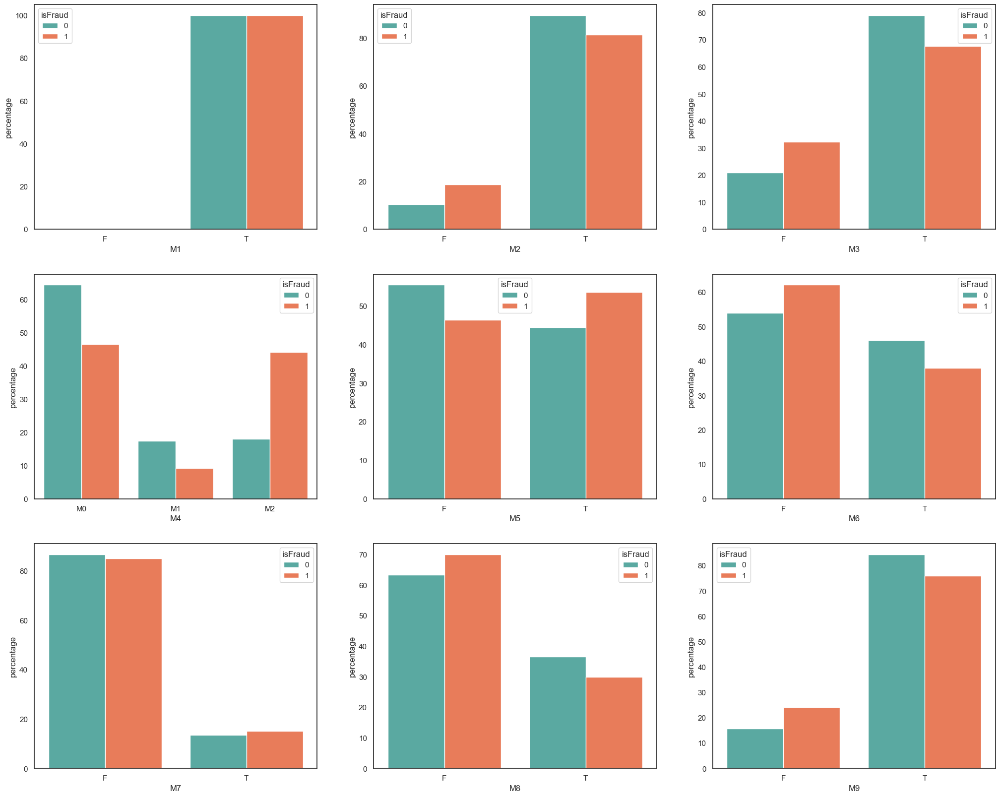

In [352]:
plt.figure(figsize = (25,20))

var = ['train_m' + str(i) for i in range(1,10)]
col = ['M' + str(i) for i in range(1,10)]

for i, j, k in zip( var, col, range(1,10)):

    i = (train_df.groupby(['isFraud'])[j]
         
                         .value_counts(normalize = True)
                         .rename('percentage')
                         .mul(100)
                         .reset_index()
                         .sort_values(j))
    palette = ["#4DB6AC", "#FF7043"]
    plt.subplot(3,3,k)
    sns.barplot(x = j, y = "percentage", hue = "isFraud", data = i, palette = palette)
plt.show();

In [353]:
# Select all columns starting with 'V'
v_features = [col for col in train_df.columns if col.startswith('V')]

print(f"Number of V features: {len(v_features)}")
print(f"Sample V features: {v_features[:5]}...\n")

# Display the first 5 rows of all V features
train_df[v_features].head()


Number of V features: 339
Sample V features: ['V1', 'V2', 'V3', 'V4', 'V5']...



,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [354]:
train_df[v_feature].describe()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
count,311240.000000,311240.000000,311240.000000,311240.000000,311240.000000,311240.000000,311240.000000,311240.000000,311240.000000,311240.000000,311240.000000,514450.000000,514450.000000,514450.000000,514450.000000,514450.000000,514450.000000,514450.000000,514450.000000,514450.000000,514450.000000,514450.000000,514450.000000,514450.000000,514450.000000,514450.000000,514450.000000,514450.000000,514450.000000,514450.000000,514450.000000,514450.000000,514450.000000,514450.000000,421554.000000,421554.000000,421554.000000,421554.000000,421554.000000,421554.000000,421554.000000,421554.000000,421554.000000,421554.000000,421554.000000,421554.000000,421554.000000,421554.000000,421554.000000,421554.000000,421554.000000,421554.000000,513427.000000,513427.000000,513427.000000,513427.000000,513427.000000,513427.000000,513427.000000,513427.000000,513427.000000,513427.000000,513427.000000,513427.000000,513427.000000,513427.000000,513427.000000,513427.000000,513427.000000,513427.000000,513427.000000,513427.000000,513427.000000,513427.000000,501359.000000,501359.000000,501359.000000,501359.000000,501359.000000,501359.000000,501359.000000,501359.000000,501359.000000,501359.000000,501359.000000,501359.000000,501359.000000,501359.000000,501359.000000,501359.000000,501359.000000,501359.000000,501359.000000,501359.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,590207.000000,81943.000000,81943.000000,81943.000000,81943.000000,81943.000000,81949.000000,81949.000000,81949.000000,81943.000000,81943.000000,81943.000000,81943.000000,81949.000000,81949.000000,81949.000000,81943.000000,81943.000000,81943.000000,81943.000000,81943.000000,81943.000000,81949.000000,81949.000000,81943.000000,81943.000000,81943.000000,81949.000000,81949.000000,81949.000000,139625.000000,139625.000000,139813.000000,139813.000000,139813.00000,139625.000000,139625.000000,139813.000000,

In [355]:
import numpy as np

for f in v_feature:
    print(f"\n{'='*10} {f} {'='*10}")
    
    unique_values = train_df[f].nunique(dropna=True)
    top_value = train_df[f].value_counts(dropna=True).head(1)

    print(f"Top value count:\n{top_value}")
    print(f"\nFeature '{f}' has {unique_values} unique non-null values.\n")


========== V1 ==========
Top value count:
V1
1.0    311223
Name: count, dtype: int64

Feature 'V1' has 2 unique non-null values.


========== V2 ==========
Top value count:
V2
1.0    298883
Name: count, dtype: int64

Feature 'V2' has 9 unique non-null values.


========== V3 ==========
Top value count:
V3
1.0    290572
Name: count, dtype: int64

Feature 'V3' has 10 unique non-null values.


========== V4 ==========
Top value count:
V4
1.0    246489
Name: count, dtype: int64

Feature 'V4' has 7 unique non-null values.


========== V5 ==========
Top value count:
V5
1.0    242872
Name: count, dtype: int64

Feature 'V5' has 7 unique non-null values.


========== V6 ==========
Top value count:
V6
1.0    298616
Name: count, dtype: int64

Feature 'V6' has 10 unique non-null values.


========== V7 ==========
Top value count:
V7
1.0    291474
Name: count, dtype: int64

Feature 'V7' has 10 unique non-null values.


========== V8 ==========
Top value count:
V8
1.0    303455
Name: count, dtype: 

In [356]:
train_df.to_csv("data/train_afterEDA.csv", index=False)
test_df.to_csv("data/test_afterEDA.csv", index=False)